In [2]:
import pandas as pd
import folium
from folium import plugins
import geocoder
import geopy
import numpy as np
from branca.element import Figure

In [3]:
for df in pd.read_csv('data/trajectories_stokes_subset_10000.csv.gz', chunksize=10007, usecols=['lat', 'lon']):
    new_df = df
    break
new_df= new_df.dropna()
print(new_df)

             lat       lon
0      43.288517  5.171321
1      43.296562  4.982898
2      43.294650  4.962841
3      43.280422  5.100956
4      43.294853  5.134313
...          ...       ...
10002  36.714317 -2.025907
10003  36.682793 -2.050557
10004  36.869358 -1.898651
10005  36.711742 -2.247585
10006  36.701720 -2.251942

[10007 rows x 2 columns]


In [20]:
## Circle Markers
map_circle = folium.Map(location=[42.588517, 5.171321], zoom_start=8)

### Map options
# plugin for mini map
minimap = plugins.MiniMap(toggle_display=True)

# add minimap to map
map_circle.add_child(minimap)

# add scroll zoom toggler to map
plugins.ScrollZoomToggler().add_to(map_circle)

# add full screen button to map
plugins.Fullscreen(position='topright').add_to(map_circle)


## Trajectory data
for index,row in new_df.iterrows():
    folium.CircleMarker(location=[row.lat, row.lon], radius=3, color='#F57C00', fill_color='green').add_to(map_circle)

map_circle.save('maps/stokes_map1.html')

map_1 = Figure(height=450)
map_1.add_child(map_circle)

map_1

In [13]:
df = pd.read_csv('data/trajectories_stokes_subset_10000.csv.gz', usecols=['obs', 'traj', 'MPA', 'lat', 'lon'])
trajs = {}

for i in range(0,10021):
    trajs[str(i)] = df.loc[df['traj'] == i] 

In [14]:
trajs["100"]

,obs,traj,MPA,lat,lon
100,0,100,1.0,43.299885,5.314856
10121,1,100,1.0,43.294964,5.322164
20142,2,100,1.0,43.289566,5.329379
30163,3,100,1.0,43.283768,5.336390
40184,4,100,1.0,43.278233,5.342509
...,...,...,...,...,...
9590197,957,100,10.0,43.225895,5.374989
9600218,958,100,10.0,43.225895,5.374989
9610239,959,100,10.0,43.225895,5.374989
9620260,960,100,10.0,43.225895,5.374989


In [21]:
## Antpath map
antpath_map = folium.Map(location=[42.288517, 5.171321], zoom_start=7)
# add scroll zoom toggler to map
plugins.ScrollZoomToggler().add_to(antpath_map)

for i in range(0,10):
    traj_route_lats = np.array(trajs[str(i)].lat)
    traj_route_lon = np.array(trajs[str(i)].lon)
    traj_routes = np.vstack((traj_route_lats,traj_route_lon)).T    
    
    folium.CircleMarker(location=[traj_route_lats[0], traj_route_lon[0]], radius=4, color='green').add_to(antpath_map)
    folium.CircleMarker(location=[traj_route_lats[-1], traj_route_lon[-1]], radius=3, color='red').add_to(antpath_map)
    
    plugins.AntPath(traj_routes).add_to(antpath_map)

    
map_2 = Figure(height=450)
map_2.add_child(antpath_map)
antpath_map.save('maps/stokes_map2.html')
map_2  

In [22]:
def load_and_subset_trajectories(
    file_name, num_traj=300, use_random=False
):

    df = pd.read_csv(file_name)

    # the whole dataset is too big to open here.
    if use_random:
        # Let's subset to fewer random trajectories:
        random_trajs = np.random.choice(
            np.unique(df["traj"]), num_traj, replace=False
        )
        traj_mask = df["traj"].apply(lambda x: x in random_trajs)
    else:
        # Let's use the first N trajectories
        first_n_trajs = np.unique(df["traj"])[:num_traj]
        traj_mask = df["traj"].apply(lambda x: x in first_n_trajs)
    
    df = df[traj_mask]
    
    return df

In [24]:
df1 = load_and_subset_trajectories("data/trajectories_stokes_subset_10000.csv.gz")

In [25]:
df1 = df1.set_index(["traj", "obs"]).sort_index(level=0)
df1

MPA    distance  land        lat       lon       temp  \
traj obs                                                          
0    0    1.0    0.000000   0.0  43.288517  5.171321  13.421764   
     1    1.0    0.843716   0.0  43.285854  5.181101  13.429676   
     2    1.0    1.645409   0.0  43.283524  5.190491  13.436654   
     3    1.0    2.403811   0.0  43.281498  5.199454  13.442868   
     4    1.0    3.123281   0.0  43.279760  5.208031  13.448405   
...       ...         ...   ...        ...       ...        ...   
299  957  0.0  624.659500   0.0  40.176200  6.797083  25.572657   
     958  0.0  625.336400   0.0  40.174015  6.804533  25.578049   
     959  0.0  626.014160   0.0  40.172066  6.812105  25.583246   
     960  0.0  626.696200   0.0  40.170307  6.819810  25.588346   
     961  0.0  626.753300   0.0  40.170166  6.820457  25.588772   

                         time         z  
traj obs                                 
0    0             2017-03-01  1.018237  
     1    2017-03-01 01:00:00  1.018237  
     2    2017-03-01 02:00:00  1.018237  
     3    2017-03-01 03:00:00  1.018237  
     4    2017-03-01 04:00:00  1.018237  
...                       ...       ...  
299  957  2017-08-13 21:00:00  1.018237  
     958  2017-08-13 22:00:00  1.018237  
     959  2017-08-13 23:00:00  1.018237  
     960  2017-08-14 00:00:00  1.018237  
     961           2017-08-14  1.018237  

[288600 rows x 8 columns]

In [26]:
df1 = df1[["lat", "lon"]]
df1

lat       lon
traj obs                     
0    0    43.288517  5.171321
     1    43.285854  5.181101
     2    43.283524  5.190491
     3    43.281498  5.199454
     4    43.279760  5.208031
...             ...       ...
299  957  40.176200  6.797083
     958  40.174015  6.804533
     959  40.172066  6.812105
     960  40.170307  6.819810
     961  40.170166  6.820457

[288600 rows x 2 columns]

In [27]:
num_bins_lat = 10
num_bins_lon = 30

lat_bins = np.linspace(df1["lat"].min(), df1["lat"].max(), num_bins_lat)
lon_bins = np.linspace(df1["lon"].min(), df1["lon"].max(), num_bins_lon)

In [28]:
df1["lat_bin"] = np.digitize(df1["lat"], lat_bins, right=True)
df1["lon_bin"] = np.digitize(df1["lon"], lon_bins, right=True)

df1["bin_tup"] = list(zip(df1["lat_bin"], df1["lon_bin"]))

df1["lat_bin_pos"] = lat_bins[np.digitize(df1["lat"], lat_bins, right=True)] - 0.5 * np.diff(lat_bins)[0]
df1["lon_bin_pos"] = lon_bins[np.digitize(df1["lon"], lon_bins, right=True)] - 0.5 * np.diff(lon_bins)[0]

df1

C:\Users\Home\anaconda3\lib\site-packages\ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.
C:\Users\Home\anaconda3\lib\site-packages\ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\Users\Home\anaconda3\lib\site-packages\ipykernel_launcher.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in th

lat       lon  lat_bin  lon_bin  bin_tup  lat_bin_pos  \
traj obs                                                                
0    0    43.288517  5.171321        9       15  (9, 15)    43.215361   
     1    43.285854  5.181101        9       15  (9, 15)    43.215361   
     2    43.283524  5.190491        9       15  (9, 15)    43.215361   
     3    43.281498  5.199454        9       15  (9, 15)    43.215361   
     4    43.279760  5.208031        9       15  (9, 15)    43.215361   
...             ...       ...      ...      ...      ...          ...   
299  957  40.176200  6.797083        3       21  (3, 21)    40.146547   
     958  40.174015  6.804533        3       21  (3, 21)    40.146547   
     959  40.172066  6.812105        3       21  (3, 21)    40.146547   
     960  40.170307  6.819810        3       21  (3, 21)    40.146547   
     961  40.170166  6.820457        3       21  (3, 21)    40.146547   

          lon_bin_pos  
traj obs               
0    0       5.264897  
     1       5.264897  
     2       5.264897  
     3       5.264897  
     4       5.264897  
...               ...  
299  957     6.771288  
     958     6.771288  
     959     6.771288  
     960     6.771288  
     961     6.771288  

[288600 rows x 7 columns]

In [29]:
ref_traj = 6

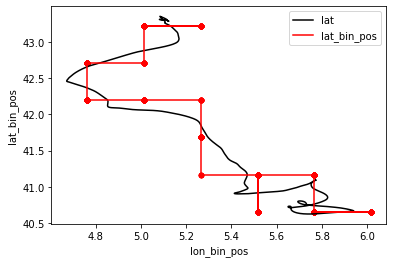

In [30]:
ax = df1.loc[ref_traj].plot.line(x="lon", y="lat", c="k")
df1.loc[ref_traj].plot.scatter(x="lon_bin_pos", y="lat_bin_pos", c="r", ax=ax);
df1.loc[ref_traj].plot.line(x="lon_bin_pos", y="lat_bin_pos", c="r", ax=ax);

In [31]:
from editdistance import distance as edist

In [32]:
df1.loc[df1.index.levels[0][ref_traj]]

,lat,lon,lat_bin,lon_bin,bin_tup,lat_bin_pos,lon_bin_pos
obs,,,,,,,
0,43.302692,5.095328,9,14,"(9, 14)",43.215361,5.013832
1,43.304523,5.093338,9,14,"(9, 14)",43.215361,5.013832
2,43.306070,5.091500,9,14,"(9, 14)",43.215361,5.013832
3,43.307220,5.089628,9,14,"(9, 14)",43.215361,5.013832
4,43.308200,5.087857,9,14,"(9, 14)",43.215361,5.013832
...,...,...,...,...,...,...,...
957,40.769650,5.731543,4,17,"(4, 17)",40.658016,5.767027
958,40.763980,5.732437,4,17,"(4, 17)",40.658016,5.767027
959,40.758140,5.733198,4,17,"(4, 17)",40.658016,5.767027


In [33]:
dist_to_ref = np.array([
    edist(
        df1.loc[traj]["bin_tup"],
        df1.loc[df1.index.levels[0][ref_traj]]["bin_tup"]
    )
    for traj in df1.index.levels[0]
])

In [34]:
from matplotlib import pyplot as plt

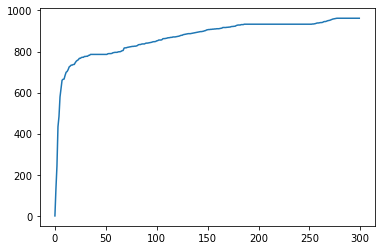

In [35]:
plt.plot(np.sort(dist_to_ref))

In [36]:
trajs_close_to_ref = df1.index.levels[0][dist_to_ref < 750]
trajs_close_to_ref

Int64Index([  6,   7,   8,  40,  53,  62,  73,  76, 132, 155, 163, 164, 176,
            197, 200, 210, 220, 226, 244, 259, 277],
           dtype='int64', name='traj')

<AxesSubplot:xlabel='lon'>

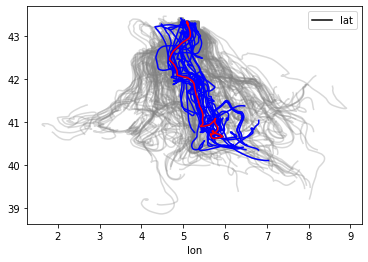

In [37]:
ax = df1.loc[trajs_close_to_ref[0]].plot.line(x="lon", y="lat", c="k")
for traj in df1.index.levels[0]:
    df1.loc[traj].plot.line(x="lon", y="lat", c="gray", alpha=0.3, ax=ax, legend=False)
for traj in trajs_close_to_ref:
    df1.loc[traj].plot.line(x="lon", y="lat", c="blue", ax=ax, legend=False)
df1.loc[trajs_close_to_ref[0]].plot.line(x="lon", y="lat", c="r", ax=ax, legend=False)

In [40]:
## Antpath map
cluster_map = folium.Map(location=[42.288517, 5.171321], zoom_start=7)
# add scroll zoom toggler to map
plugins.ScrollZoomToggler().add_to(cluster_map)

for i in df1.index.levels[0]:
    traj_route_lats = np.array(df1.loc[i].lat)
    traj_route_lon = np.array(df1.loc[i].lon)
    traj_routes = np.vstack((traj_route_lats,traj_route_lon)).T    
    
#     folium.CircleMarker(location=[traj_route_lats[-1], traj_route_lon[-1]], radius=3, color='red').add_to(antpath_map)
    folium.PolyLine(traj_routes, color='gray', weight=1, opacity=0.6).add_to(cluster_map)
    
for i in trajs_close_to_ref:
    traj_route_lats = np.array(df1.loc[i].lat)
    traj_route_lon = np.array(df1.loc[i].lon)
    traj_routes = np.vstack((traj_route_lats,traj_route_lon)).T    
    
    folium.PolyLine(traj_routes, color='#03A9F4', weight=2, opacity=0.7).add_to(cluster_map)
    
traj_close_to_ref_lat = np.array(df1.loc[trajs_close_to_ref[1]].lat)
traj_close_to_ref_lon = np.array(df1.loc[trajs_close_to_ref[1]].lon)
traj_close_to_ref_routes = np.vstack((traj_close_to_ref_lat,traj_close_to_ref_lon)).T
folium.PolyLine(traj_close_to_ref_routes, color='red', weight=3, opacity=0.8).add_to(cluster_map)


ref_traj_lat = np.array(df1.loc[ref_traj].lat)
ref_traj_lon = np.array(df1.loc[ref_traj].lon)
ref_traj_routes = np.vstack((ref_traj_lat,ref_traj_lon)).T
plugins.AntPath(ref_traj_routes).add_to(cluster_map)

    
map_3 = Figure(height=450)
map_3.add_child(cluster_map)
cluster_map.save('maps/stokes_map3.html')
map_3